# SConvNet

In [3]:
# Imports
import os
from keras.layers import *
from keras.models import Model, load_model
from keras.regularizers import l2
from keras.callbacks import ModelCheckpoint
from keras.optimizers import RMSprop, Adam, SGD
import matplotlib.pyplot as plt
import scipy.misc as m
from utils.utils import *

## Model

In [4]:
from networks.models import SConvNet

sconv_model = SConvNet(29)
sconv_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, None, None, 8)     224       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, None, None, 8)     584       
_________________________________________________________________
conv2d_18 (Conv2D)           (None, None, None, 8)     584       
_________________________________________________________________
conv2d_19 (Conv2D)           (None, None, None, 16)    1168      
_________________________________________________________________
conv2d_20 (Conv2D)           (None, None, None, 16)    2320      
_________________________________________________________________
conv2d_21 (Conv2D)           (None, None, None, 16)    2320      
__________

# DRIVE

## Read image names

In [4]:
dir_drive = "/home/augustocms/datasets/drive/training/"
dir_img = dir_drive + "images/"
dir_seg = dir_drive + "1st_manual/"
dir_test = "/home/augustocms/datasets/drive/test/"
dir_test_img = dir_test + "images/"
dir_test_seg = dir_test + "1st_manual/"
dir_mask = dir_drive + "mask/"

with open(dir_drive + 'train.txt') as f:
    x = f.read().splitlines()
imgs = np.array(x)

with open(dir_drive + 'val.txt') as f:
    x = f.read().splitlines()
val_imgs = np.array(x)

with open(dir_test + 'test.txt') as f:
    x = f.read().splitlines()
test_imgs = np.array(x)

print(imgs[0])

21_training.tif 21_manual1.gif 21_training_mask.gif


## Load Data

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  import sys
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  


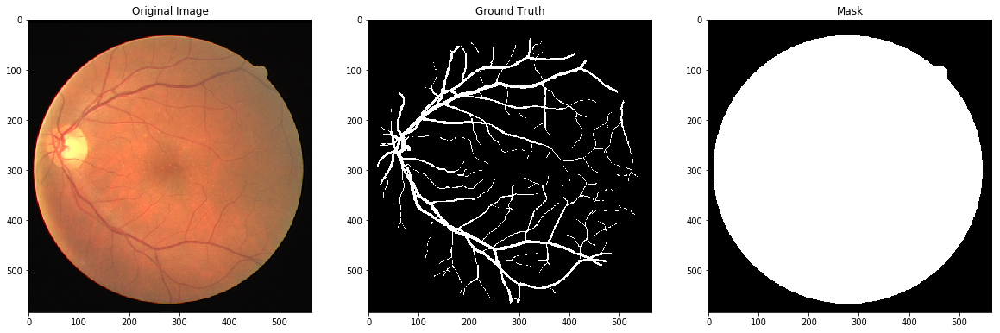

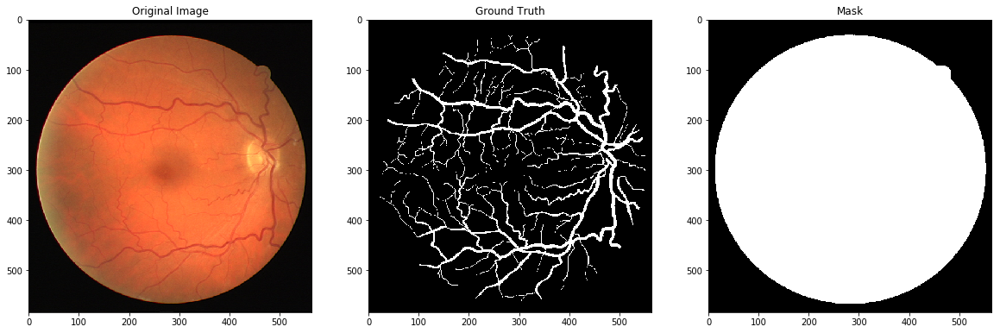

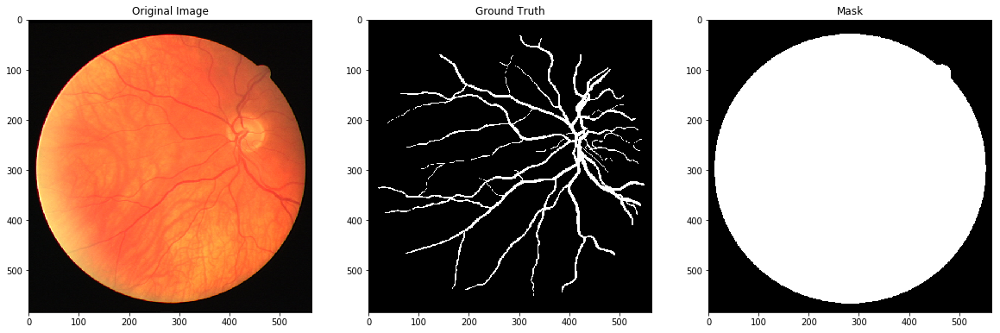

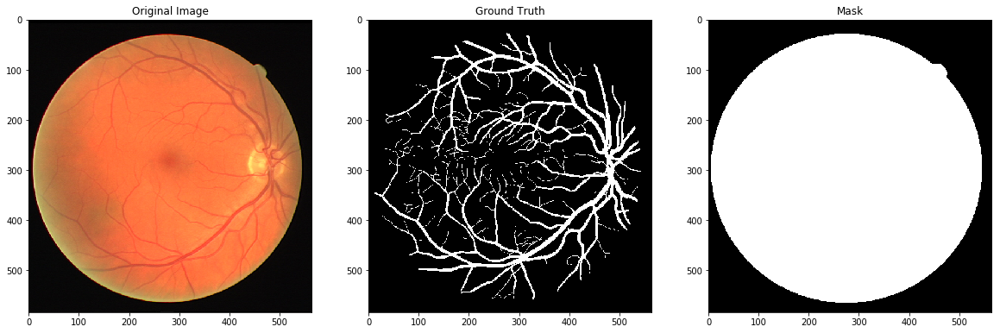

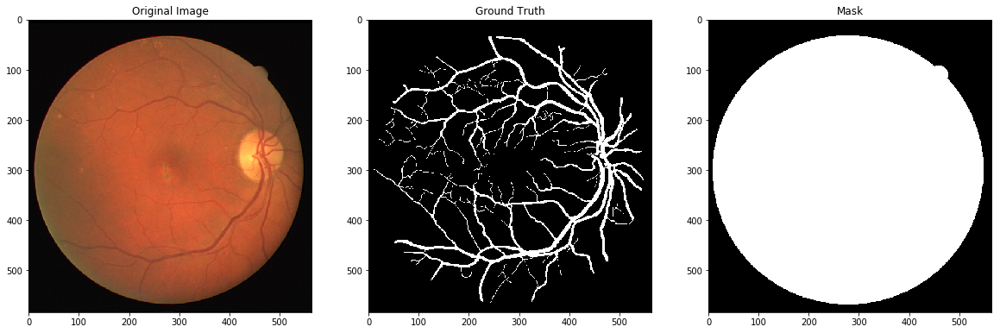

...

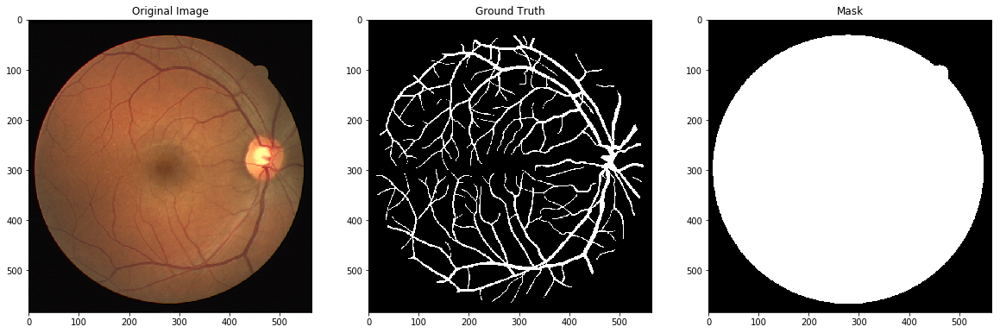

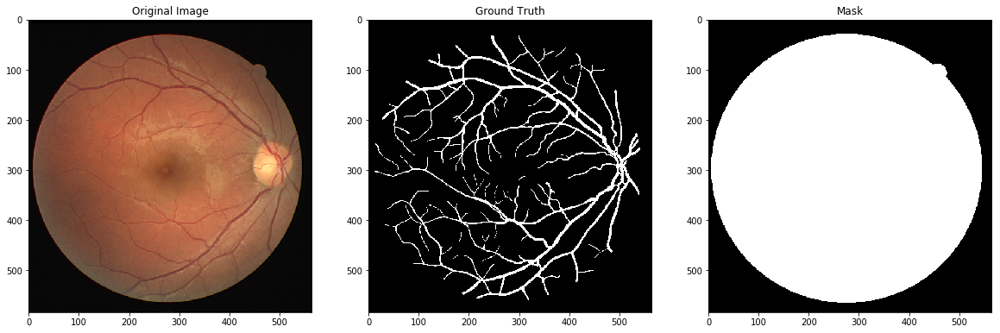

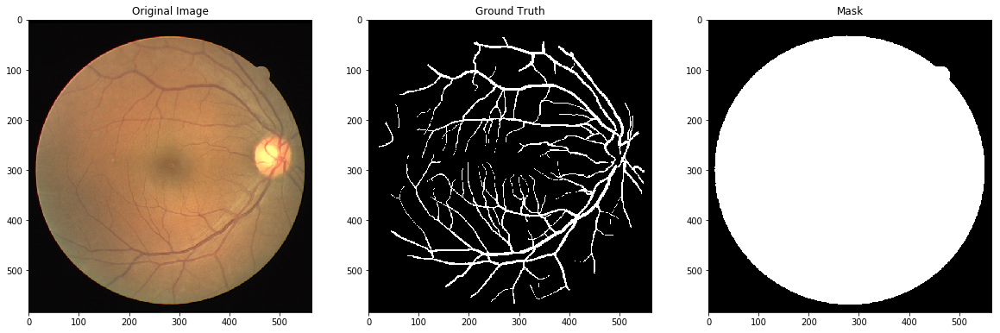

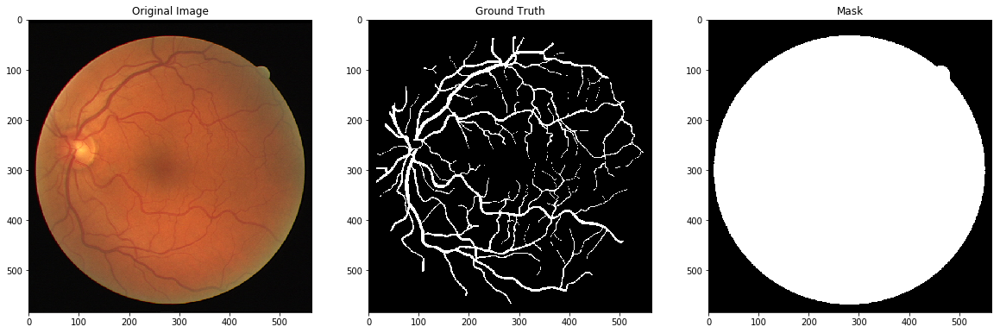

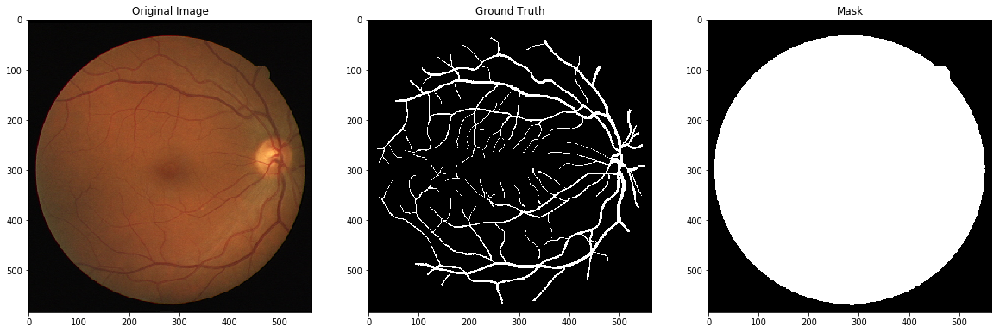

In [6]:
images = []
gt = []
mask = []
for line in imgs:
    names = line.split(' ')
    img = m.imread(dir_img + names[0])
    seg = m.imread(dir_seg + names[1])
    maskim = m.imread(dir_mask + names[2])
    images.append(img)
    gt.append(seg)
    mask.append(maskim)
    
    fig = plt.figure(figsize=(20,40))
    ax = fig.add_subplot(1,3,1)
    ax.imshow(img)
    ax.set_title("Original Image")

    ax = fig.add_subplot(1,3,2)
    ax.imshow(seg, cmap='gray')
    ax.set_title('Ground Truth')
    
    ax = fig.add_subplot(1,3,3)
    ax.imshow(maskim, cmap='gray')
    ax.set_title('Mask')
    
    plt.show()
    
    
images = np.array(images)

In [7]:
patch_size = 29

X_train = []
y_train = []
skel = []
for i, img in enumerate(images):
    seg_img = gt[i]/255
    mask_im = mask[i]
    X_train.append(sliding_window(img, patch_size, mask_im))
    y_patches = categorize(np.array(sliding_window_gt(seg_img, patch_size, mask_im)))
    y_train.append(y_patches)

In [8]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train = np.vstack(X_train)
y_train = np.vstack(y_train)
y_train = np.reshape(y_train, (-1, 1, 1, 2))
print(X_train.shape, y_train.shape)

(4533264, 29, 29, 3) (4533264, 1, 1, 2)


In [9]:
X_val = []
y_val = []
skel_val = []
for line in val_imgs:
    names = line.split(' ')
    val_img = m.imread(dir_img + names[0])
    val_seg = m.imread(dir_seg + names[1])/255
    X_val.append(sliding_window(val_img, patch_size, mask_im))
    y_patches = categorize(np.array(sliding_window_gt(val_seg, patch_size, mask_im)))
    y_val.append(y_patches)

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  import sys


In [10]:
X_val, y_val = np.array(X_val), np.array(y_val)
X_val = np.vstack(X_val)
y_val = np.vstack(y_val)
y_val = np.reshape(y_val, (-1, 1, 1, 2))
print(X_val.shape, y_val.shape)

(907500, 29, 29, 3) (907500, 1, 1, 2)


## Training

In [11]:
opt = Adam(lr=1e-4)

sconv_model.compile(loss='binary_crossentropy',
             optimizer=opt,
             metrics=['accuracy'])

checkpoint = ModelCheckpoint('weights/sconvnet_drive.hdf5', monitor='val_loss', verbose=1, save_best_only=True, mode='min')

In [12]:
# sconv_model.load_weights('sconvnet_drive.hdf5')
# sconv_model.fit(X_train, y_train,
#           validation_data=(X_val, y_val),
#           epochs=2, batch_size=128,
#           verbose=2,
#           callbacks=[checkpoint])

# sconv_model.save('models/sconvnet_drive.h5')

sconv_model = load_model('models/sconvnet_drive.h5')

Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


## Predictions on test set

In [13]:
X_test = []
y_test = []
for line in test_imgs:
    names = line.split(' ')
    test_img = m.imread(dir_test_img + names[0])
    test_seg = m.imread(dir_test_seg + names[1])
    X_test.append(test_img)
    y_ing = categorize2d(np.array(test_seg/255))
    y_test.append(y_ing)

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  # This is added back by InteractiveShellApp.init_path()
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:12: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  if sys.path[0] == '':


In [14]:
y_test = np.array(y_test)
y_test = np.squeeze(y_test)
X_test = np.array(X_test)
print(X_test.shape, y_test.shape)

(20, 584, 565, 3) (20, 584, 565, 2)


In [17]:
y_pred = sconv_model.predict(X_test)
y_predi = np.argmax(y_pred, axis=3)
y_testi = np.argmax(y_test, axis=3)
print(y_testi.shape,y_predi.shape)

(20, 584, 565) (20, 556, 537)


In [21]:
def calc_rates(pred, gt):
    gtp = (gt >= 1).astype(int)
    pp = (pred >= 1).astype(int)
    gtn = (gt == 0).astype(int)
    pn = (pred == 0).astype(int)
   
    TP = (gtp*pp).sum()
    TN = (gtn*pn).sum()
    FP = (gtn*pp).sum()
    FN = (gtp*pn).sum()   
    return TP, TN, FP, FN


def precision(pred, gt):
    TP, TN, FP, FN = calc_rates(pred, gt)
    return TP/(TP+FP)


def recall(pred, gt):
    TP, TN, FP, FN = calc_rates(pred, gt)
    return TP/(TP+FN)


def FM(prediction, ground_truth):
    P = precision(prediction, ground_truth)
    R = recall(prediction, ground_truth)
    F = (2*P*R)/(P+R)
    return F

test_gt = y_testi
P = precision(y_predi, test_gt[:,14:-14, 14:-14])
R = recall(y_predi, test_gt[:,14:-14, 14:-14])
F = FM(y_predi, test_gt[:,14:-14, 14:-14])

print(P, R, F)

0.803236984402 0.752865020877 0.777235717169


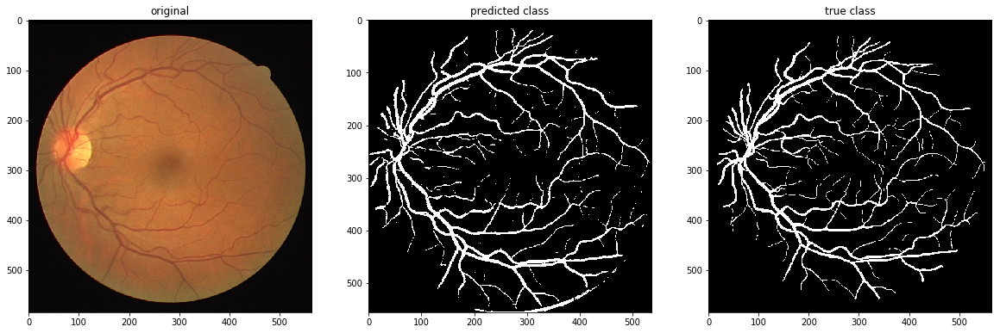

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


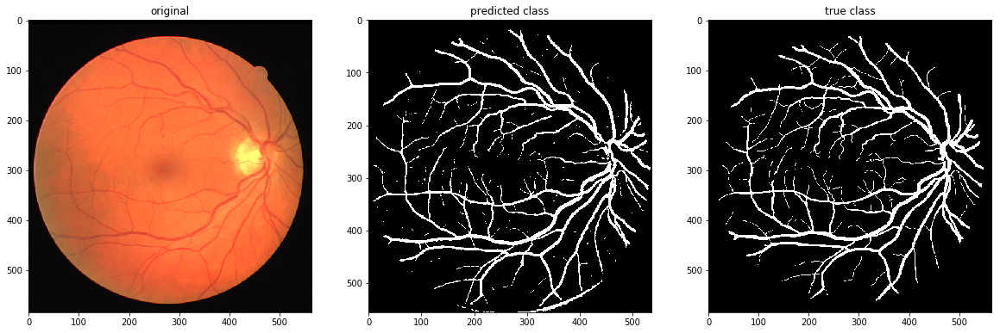

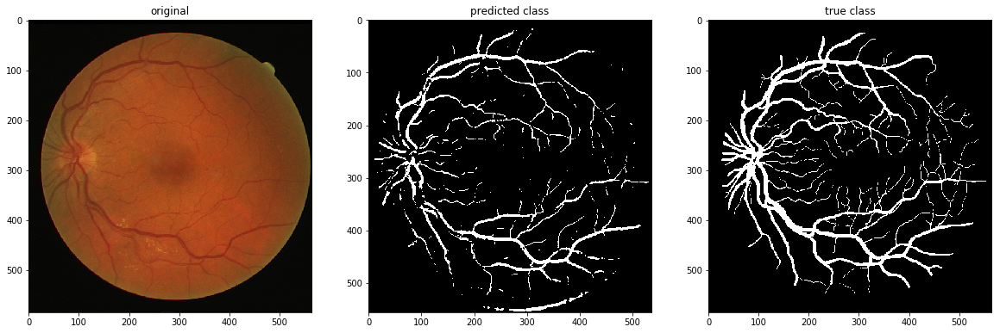

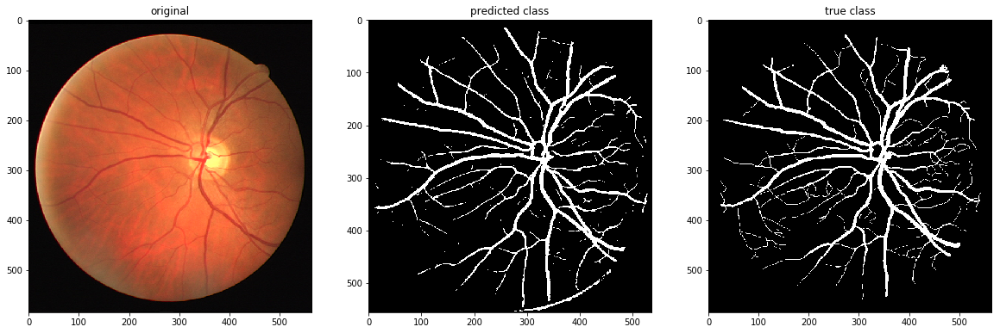

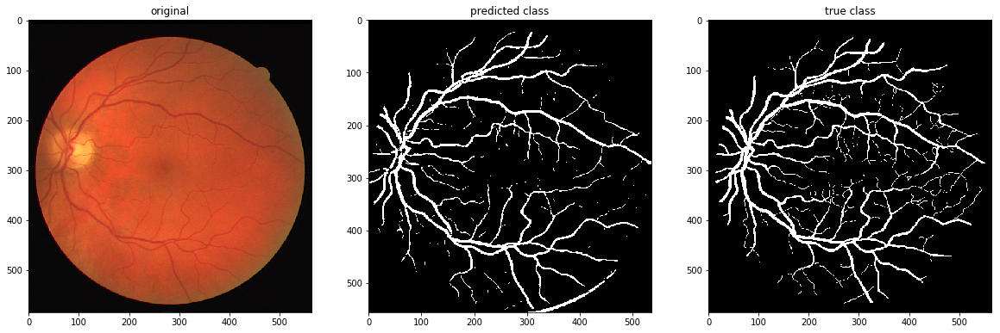

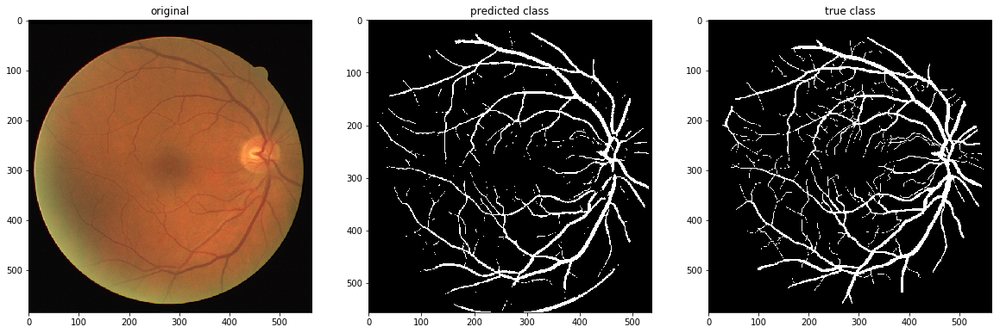

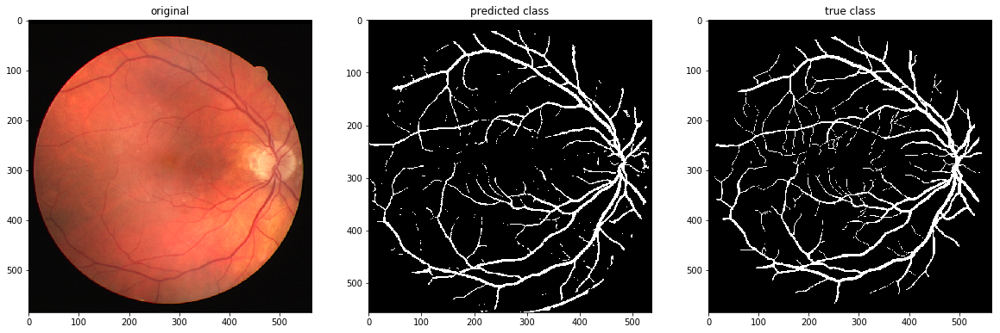

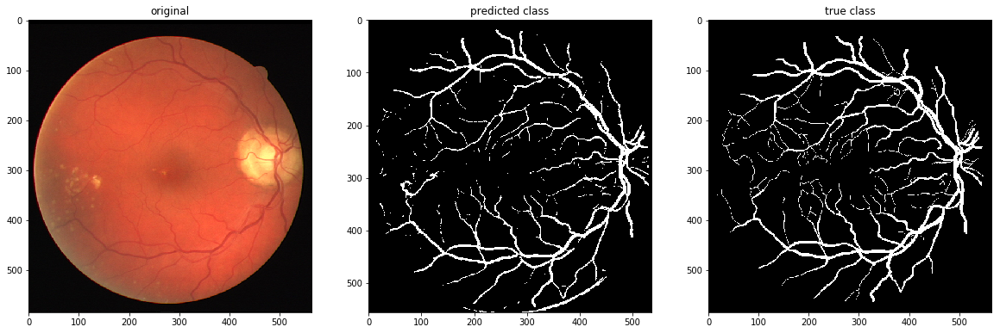

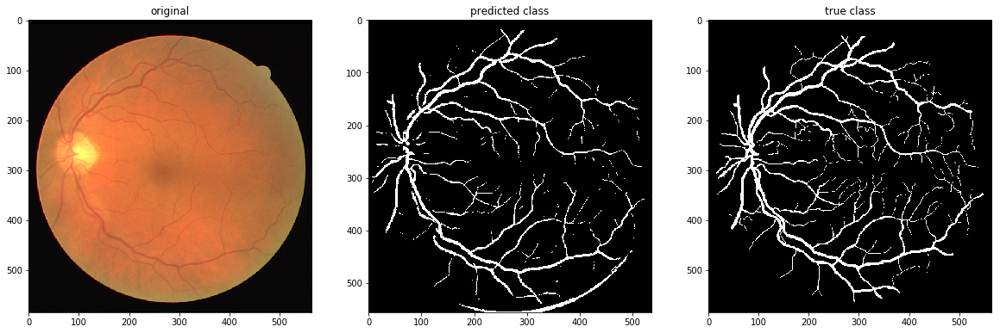

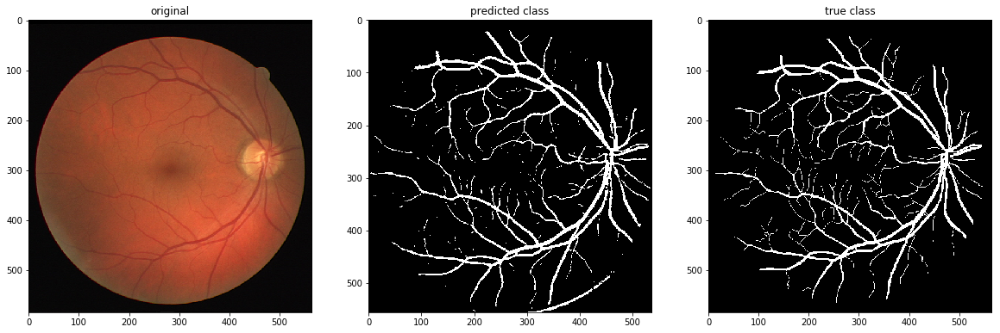

In [22]:
shape = (584, 565)
n_classes= 1

for i in range(10):
    img_is  = X_test[i]
    seg = y_predi[i]
    segtest = y_testi[i]

    fig = plt.figure(figsize=(20,40))    
    ax = fig.add_subplot(1,3,1)
    ax.imshow(img_is, cmap='gray')
    ax.set_title("original")
    
    ax = fig.add_subplot(1,3,2)
    ax.imshow(seg, cmap='gray')
    ax.set_title("predicted class")
    
    ax = fig.add_subplot(1,3,3)
    ax.imshow(segtest, cmap='gray')
    ax.set_title("true class")
    plt.show()
    
#     m.imsave('images/drive/'+str(i)+'_orig.png', img_is)
    m.imsave('images/drive/'+str(i)+'_pred_sconv.png', seg)
#     m.imsave('images/drive/'+str(i)+'_segm.png', segtest)
    

# DIBCO

## Read training and validation sets

In [5]:
dir_dibco = "/home/augustocms/scratch/DIBCO/"

with open(dir_dibco + 'train.txt') as f:
    x = f.read().splitlines()
imgs = np.array(x)

with open(dir_dibco + 'val.txt') as f:
    x = f.read().splitlines()
val_imgs = np.array(x)

with open(dir_dibco + 'test.txt') as f:
    x = f.read().splitlines()
test_imgs = np.array(x)

print(imgs[0])

2009/H01.bmp 2009/H01.tiff


## Load data

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  import sys


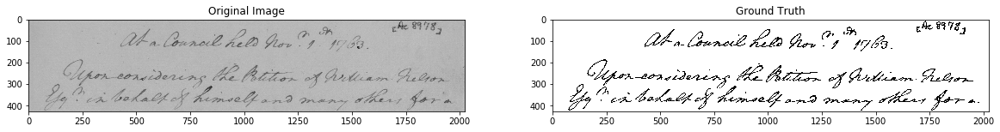

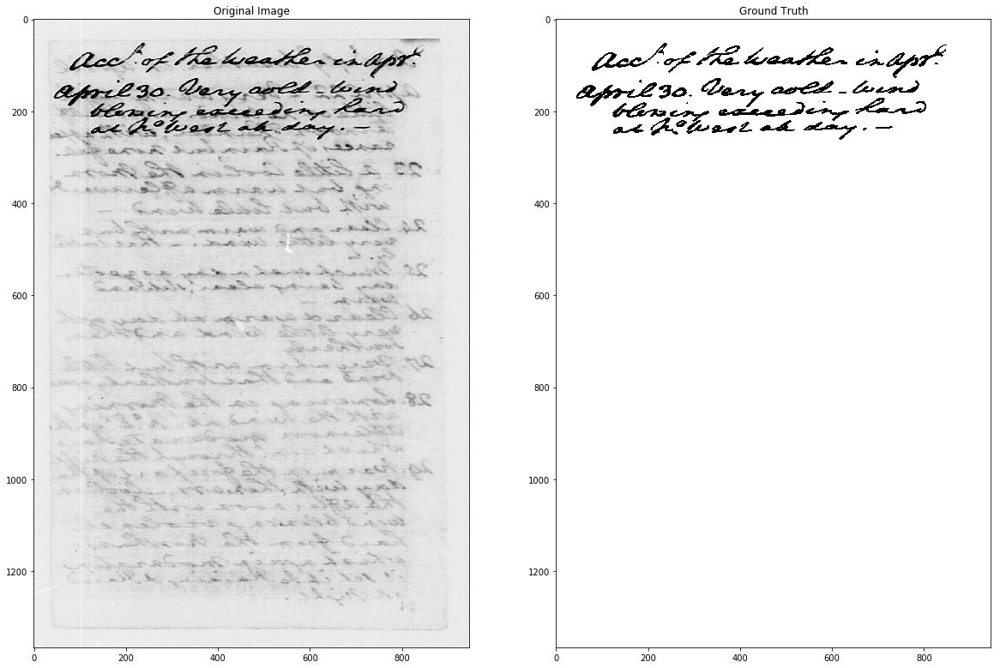

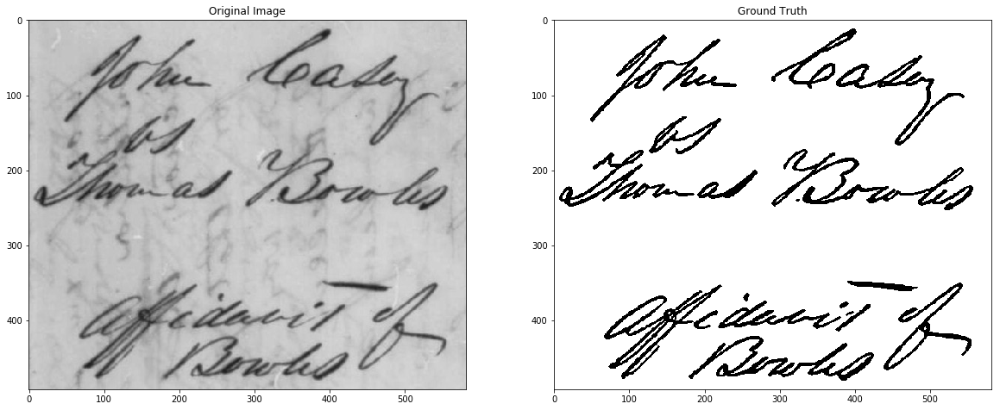

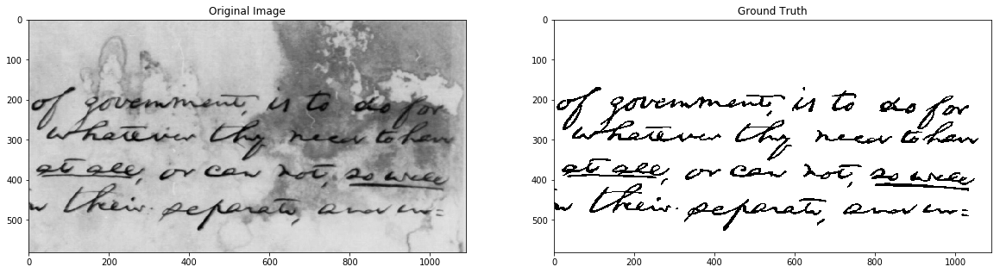

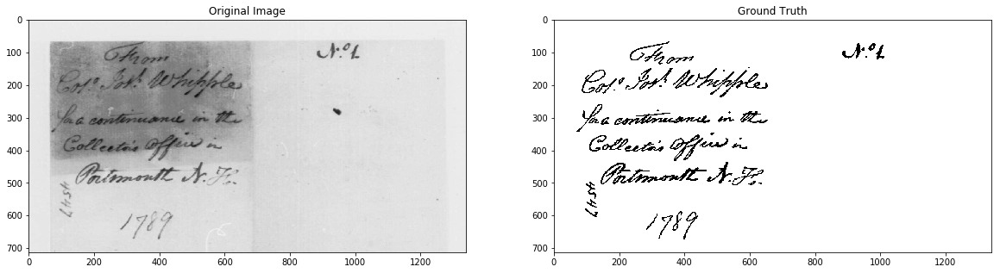

...

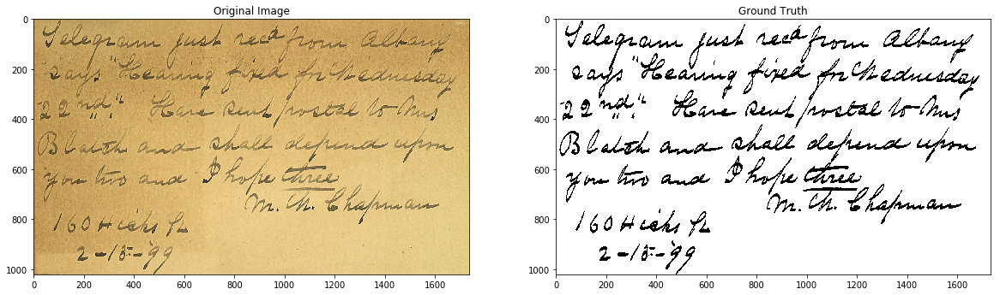

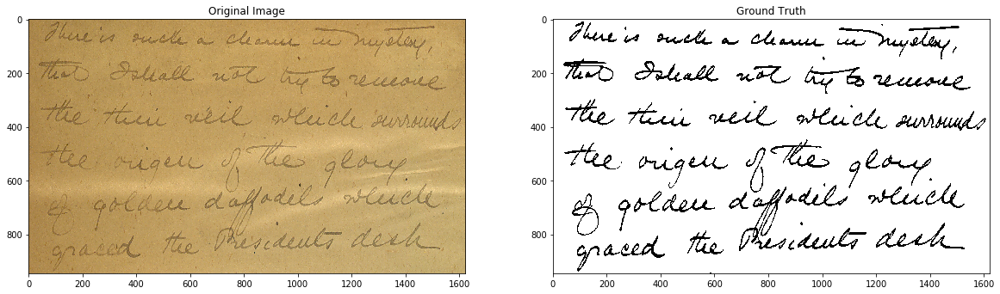

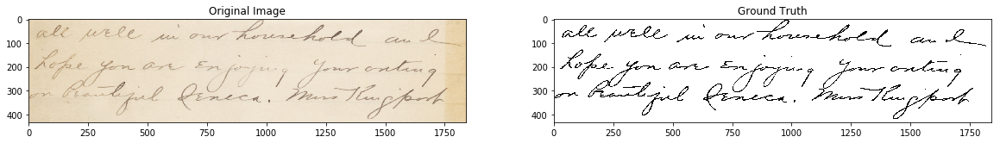

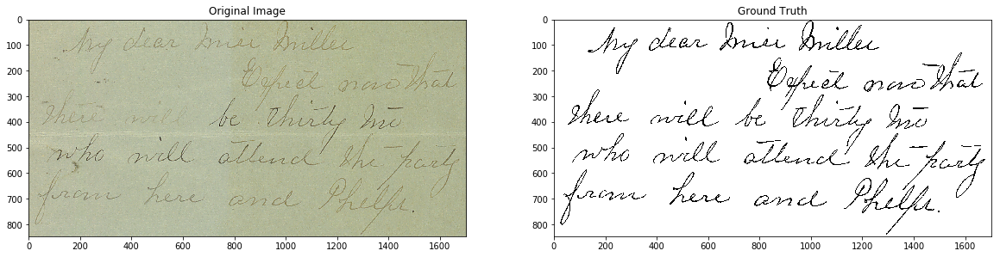

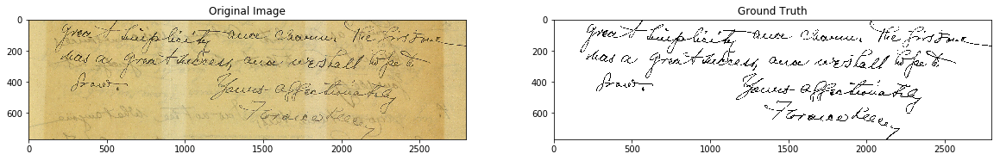

In [6]:
images = []
gt = []
mask = []
for line in imgs:
    names = line.split()
    img = m.imread(dir_dibco + names[0], mode='RGB')
    seg = m.imread(dir_dibco + names[1], mode='L')
    mask.append(np.ones(seg.shape)) # Create mask with all ones
    images.append(img)
    gt.append(seg)
    
    fig = plt.figure(figsize=(20,40))
    ax = fig.add_subplot(1,2,1)
    ax.imshow(img)
    ax.set_title("Original Image")

    ax = fig.add_subplot(1,2,2)
    ax.imshow(seg, cmap='gray')
    ax.set_title('Ground Truth')

    plt.show()
    
images = np.array(images)

In [7]:
patch_size = 29

X_train = []
y_train = []
skel = []
for i, img in enumerate(images):
    seg_img = gt[i]/255
    mask_im = mask[i]
    X_train.append(sliding_window(img, patch_size, mask_im))
    y_patches = categorize(np.array(sliding_window_gt(seg_img, patch_size, mask_im)))
    y_train.append(y_patches)

In [8]:
# X_train = np.array(X_train)
# y_train = np.array(y_train)
X_train = np.concatenate(X_train, axis=0)
y_train = np.concatenate(y_train, axis=0)
y_train = np.reshape(y_train, (-1, 1, 1, 2))
print(X_train.shape, y_train.shape)

(39924934, 29, 29, 3) (39924934, 1, 1, 2)


In [9]:
X_val = []
y_val = []
skel_val = []
for line in val_imgs:
    names = line.split()
    val_img = m.imread(dir_dibco + names[0], mode='RGB')
    val_seg = m.imread(dir_dibco + names[1], mode='L')/255
    mask_im = np.ones(val_seg.shape)
    X_val.append(sliding_window(val_img, patch_size, mask_im))
    y_patches = categorize(np.array(sliding_window_gt(val_seg, patch_size, mask_im)))
    y_val.append(y_patches)

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  import sys


In [10]:
X_val = np.concatenate(X_val, axis=0)
y_val = np.concatenate(y_val, axis=0)
y_val = np.reshape(y_val, (-1, 1, 1, 2))
print(X_val.shape, y_val.shape)

(31172865, 29, 29, 3) (31172865, 1, 1, 2)


## Training

In [11]:
sample_size_train = 4000000
sample_size_val = 3000000

# Sample data
p = np.random.permutation(X_train.shape[0])
q = np.random.permutation(X_val.shape[0])

X_train = X_train[p[:sample_size_train]]
y_train = y_train[p[:sample_size_train]]
X_val = X_val[q[:sample_size_val]]
y_val = y_val[q[:sample_size_val]]

In [12]:
opt = Adam(lr=1e-4)

sconv_model.compile(loss='binary_crossentropy',
             optimizer=opt,
             metrics=['accuracy'])

checkpoint = ModelCheckpoint('weights/sconvnet_dibco.hdf5', monitor='val_loss', verbose=1, save_best_only=True, mode='min')

In [13]:
# sconv_model.load_weights('sconvnet_dibco.hdf5')
# sconv_model.fit(X_train, y_train,
#           validation_data=(X_val, y_val),
#           epochs=10, batch_size=128,
#           verbose=1,
#           callbacks=[checkpoint])

# sconv_model.save('models/sconvnet_dibco.h5')

sconv_model = load_model('models/sconvnet_dibco.h5')

Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


## Predictions on test set

In [16]:
def crop(img, mult):
    H, W, *c = img.shape
    h = H - H%mult
    w = W - W%mult
    return img[:h,:w]
    
def padding(ing, pad):
    H, W, c = ing.shape
    padded = np.zeros((H+pad*2,W+pad*2, c), dtype=ing.dtype)
    padded[pad:-pad, pad:-pad] = ing
    return padded

X_test = []
y_test = []
for line in test_imgs:
    names = line.split()
    test_img = m.imread(dir_dibco + names[0], mode='RGB')
    test_img = padding(test_img, 14)
    test_seg = m.imread(dir_dibco + names[1], mode='L')
    X_test.append(crop(test_img, 4))
    y_ing = categorize2d(np.array(test_seg/255))
    y_test.append(crop(y_ing, 4))

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:17: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.


In [17]:
y_predi = []
y_testi = []
for i, ing in enumerate(X_test):
    y_pred = sconv_model.predict(np.asarray([ing]))
    y_predi.append(np.argmax(y_pred, axis=3))
    y_testi.append(np.argmax(y_test[i], axis=2))

In [18]:
for i, ing in enumerate(y_predi):
    gtn = (y_testi[i] == 1).astype(int)
    pn = (ing[0] == 1).astype(int)
    gtp = (y_testi[i] == 0).astype(int)
    pp = (ing[0] == 0).astype(int)

TP = (gtp*pp).sum()
TN = (gtn*pn).sum()
FP = (gtn*pp).sum()
FN = (gtp*pn).sum()

Precision = TP/(TP+FP)
Sensitivity = TP/(TP+FN)
print(Precision, Sensitivity)

0.630952863399 0.985363363262


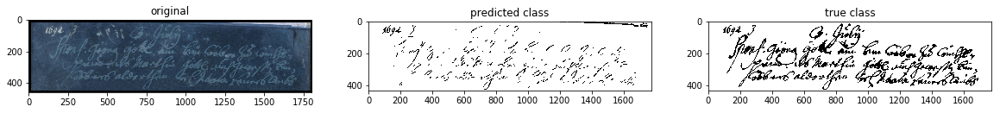

/home/augustocms/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


(460, 1804, 3) (432, 1776) (432, 1776)


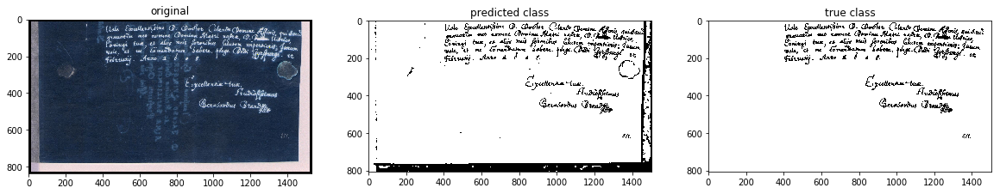

(836, 1532, 3) (808, 1504) (808, 1504)


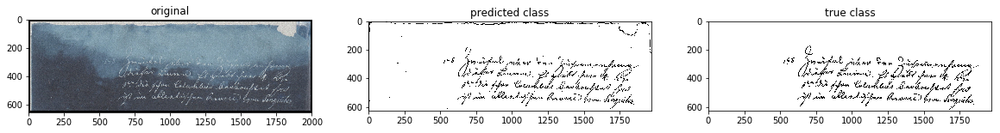

(656, 2000, 3) (628, 1972) (628, 1972)


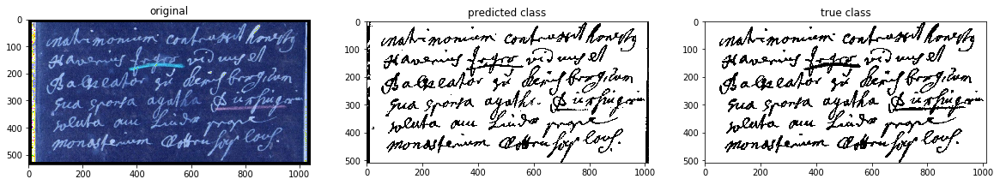

(536, 1040, 3) (508, 1012) (508, 1012)


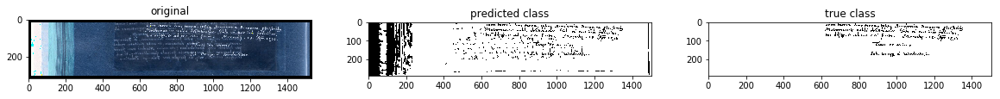

(316, 1532, 3) (288, 1504) (288, 1504)


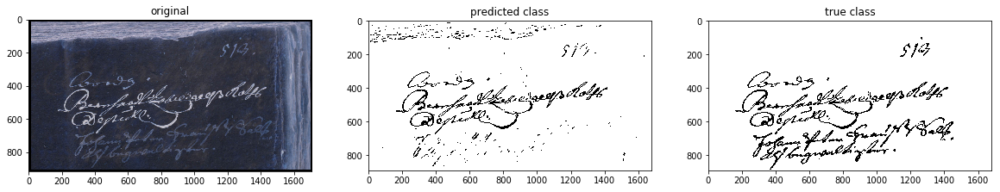

(916, 1708, 3) (888, 1680) (888, 1680)


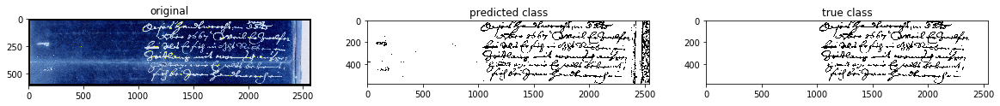

(608, 2572, 3) (580, 2544) (580, 2544)


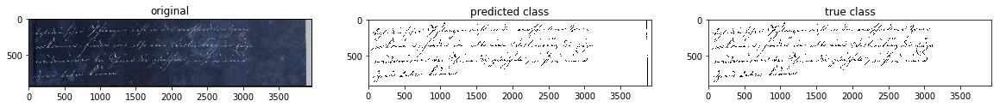

(948, 3960, 3) (920, 3932) (920, 3932)


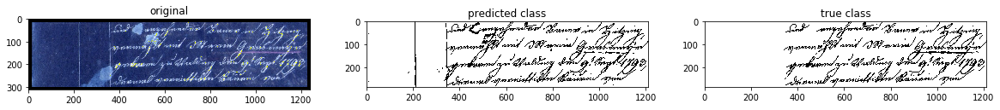

(312, 1240, 3) (284, 1212) (284, 1212)


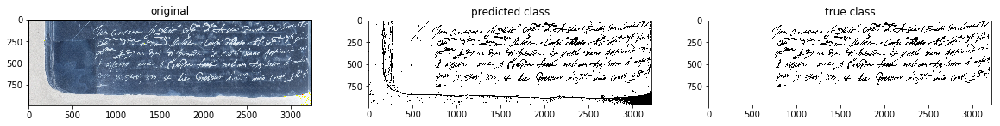

(988, 3244, 3) (960, 3216) (960, 3216)


In [19]:
for i in range(10):
    img_is  = X_test[i]
    seg = y_predi[i][0]
    segtest = y_testi[i]

    fig = plt.figure(figsize=(20,40))    
    ax = fig.add_subplot(1,3,1)
    ax.imshow(img_is, cmap='gray')
    ax.set_title("original")
    
    ax = fig.add_subplot(1,3,2)
    ax.imshow(seg, cmap='gray')
    ax.set_title("predicted class")
    
    ax = fig.add_subplot(1,3,3)
    ax.imshow(segtest, cmap='gray')
    ax.set_title("true class")
    plt.show()
    
#     m.imsave('images/dibco/'+str(i)+'_orig.png', img_is)
    m.imsave('images/dibco/'+str(i)+'_pred_sconv.png', seg)
#     m.imsave('images/dibco/'+str(i)+'_segm.png', segtest)
    
    print(img_is.shape, seg.shape, segtest.shape)